## **Adding Color to Images using DeOldify**



In this Project, I levaraged DeOldify to colorize types of images to get a better sense of how colorization works on diffrerent different types of images. DeOldify is a deep learning-based image colorization algorithm that aims to restore color to grayscale images. Below is a quick summary of how it works:
1. Input a grayscale image lacking color information.
2. Apply a decolorization step to remove remaining color information.
3. Utilize a GAN-based colorization model to generate a colorized version of the image.
4. Train the model on a dataset of colored images to learn colorization patterns.
5. Evaluate the colorization output for visual appeal and realism.

DeOldify has gained popularity for its ability to bring vibrant and realistic colors to grayscale images, particularly in historical and vintage contexts.











In [1]:
#Leveraging already created package DeOldify  for this project.
!git clone https://github.com/jantic/DeOldify.git DeOldify

Cloning into 'DeOldify'...
remote: Enumerating objects: 2603, done.
remote: Counting objects: 100% (257/257), done.
remote: Compressing objects: 100% (180/180), done.
remote: Total 2603 (delta 83), reused 208 (delta 70), pack-reused 2346
Receiving objects: 100% (2603/2603), 69.71 MiB | 33.73 MiB/s, done.
Resolving deltas: 100% (1166/1166), done.


In [2]:
cd DeOldify

/content/DeOldify


In [4]:
#NOTE:  This must be the first call in order to work properly!
from deoldify import device
from deoldify.device_id import DeviceId
#choices:  CPU, GPU0...GPU7
device.set(device=DeviceId.GPU0)

import torch

if not torch.cuda.is_available():
    print('GPU not available.')

In [6]:
import fastai
from deoldify.visualize import *
import warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*?Your .*? set is empty.*?")

INFO:numexpr.utils:NumExpr defaulting to 2 threads.


NumExpr defaulting to 2 threads.


In [7]:
!mkdir 'models'
!wget https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth -O ./models/ColorizeArtistic_gen.pth

mkdir: cannot create directory ‘models’: File exists
--2023-07-19 04:58:04--  https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth
Resolving data.deepai.org (data.deepai.org)... 185.93.1.244, 2400:52e0:1a00::894:1
Connecting to data.deepai.org (data.deepai.org)|185.93.1.244|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 255144681 (243M) [application/octet-stream]
Saving to: ‘./models/ColorizeArtistic_gen.pth’

./models/ColorizeAr 100%[===================>] 243.32M  4.81MB/s    in 50s     

2023-07-19 04:58:55 (4.85 MB/s) - ‘./models/ColorizeArtistic_gen.pth’ saved [255144681/255144681]



In [15]:
colorizer = get_image_colorizer(artistic=True)
#decolorizer = get_image_decolorizer(artistic=True)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can als

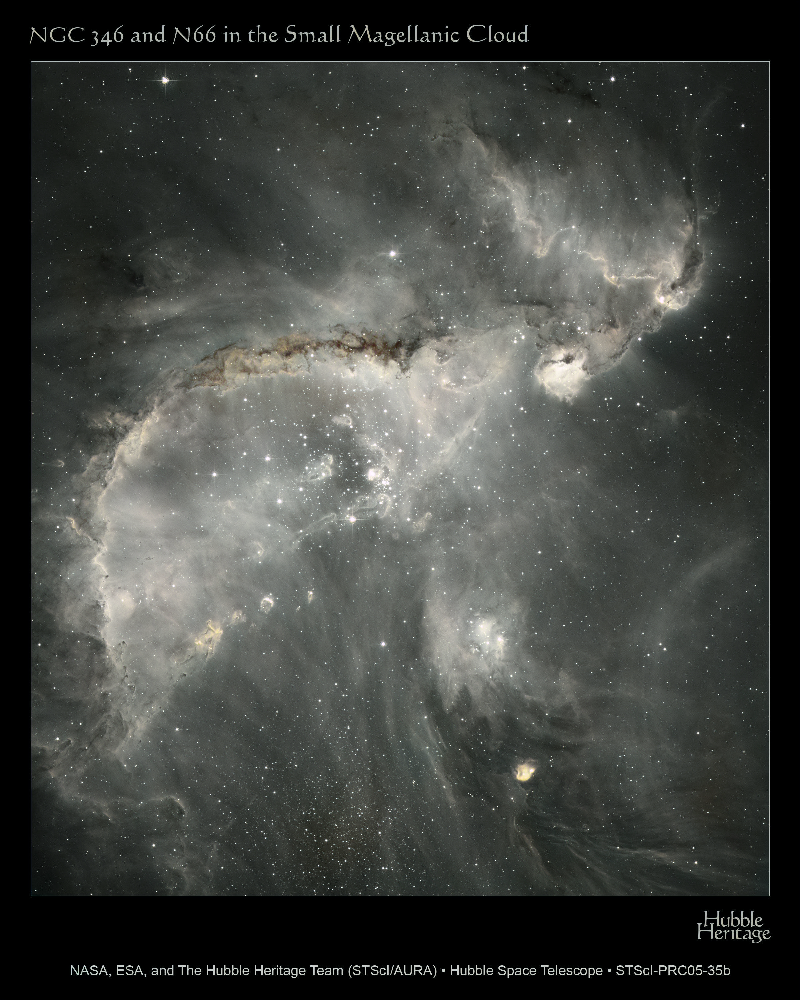

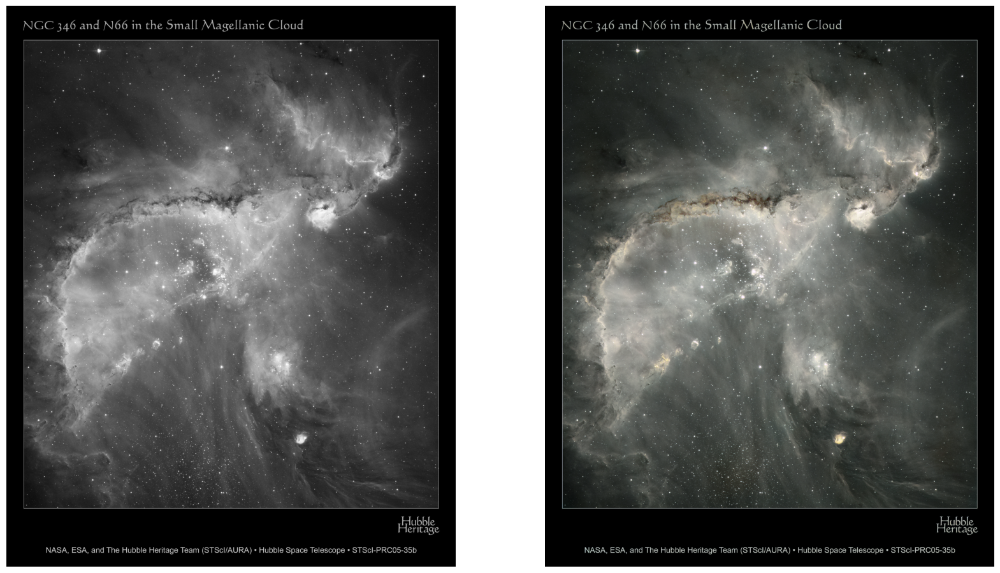

In [28]:
# for this particular image, the render factor paramter has to be much higher which is outside this project's scope
source_url = 'https://www.nasa.gov/sites/default/files/images/299819main_hs-2005-35-b-print_full.jpg'
render_factor = 100
image_path = colorizer.plot_transformed_image_from_url(url=source_url,
render_factor=render_factor, compare=True, watermarked=watermarked)
show_image_in_notebook(image_path)

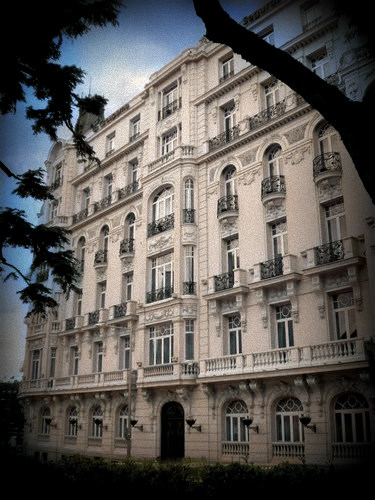

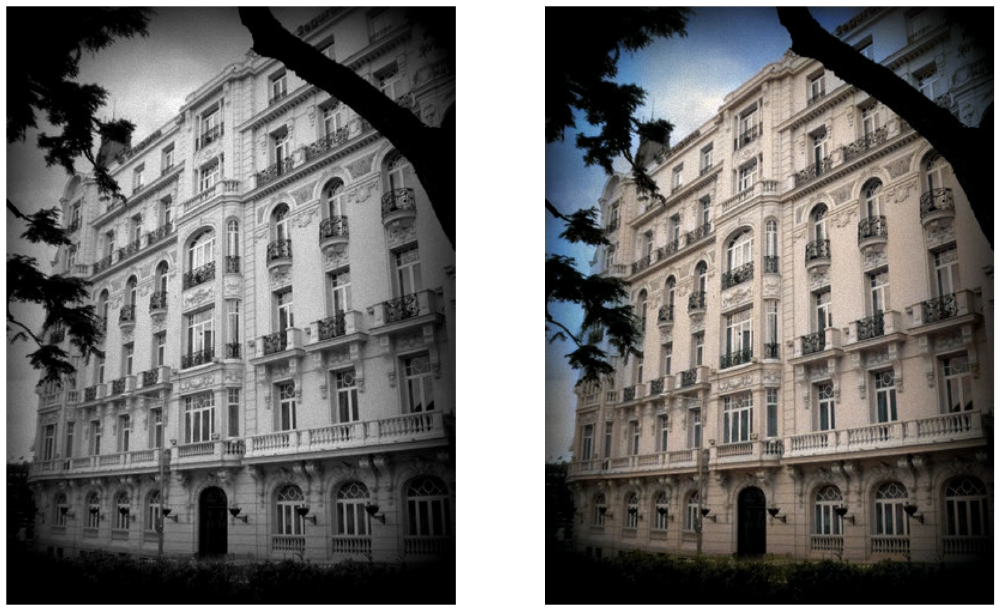

In [32]:
#testing building photos
source_url = 'https://upload.wikimedia.org/wikipedia/commons/b/be/A_Black_and_White_Photo_of_a_Building_in_Madrid_Spain.jpeg'
render_factor = 20
image_path = colorizer.plot_transformed_image_from_url(url=source_url,
render_factor=render_factor, compare=True, watermarked=watermarked)
show_image_in_notebook(image_path)

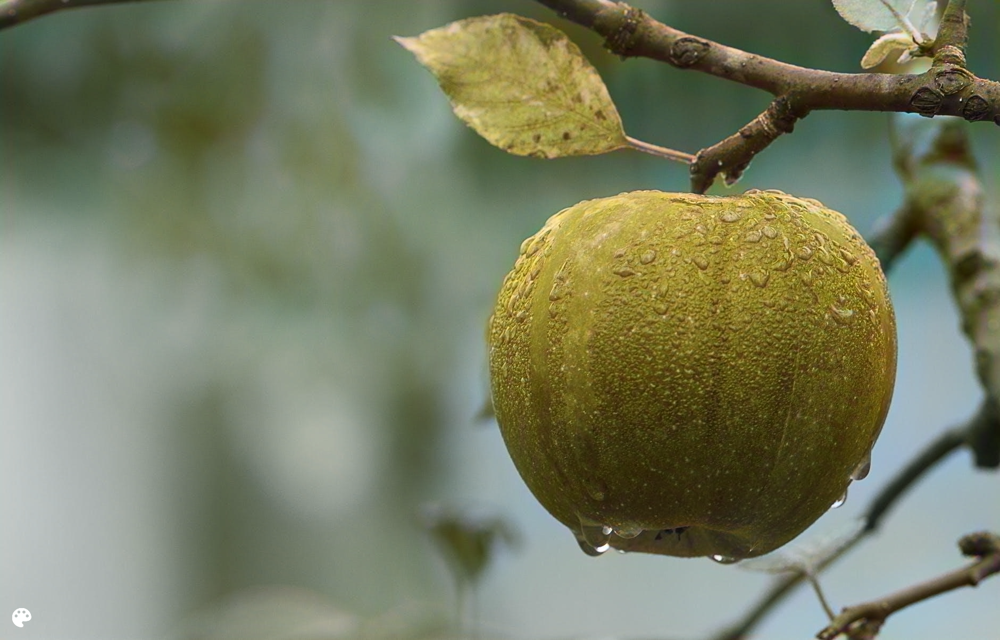

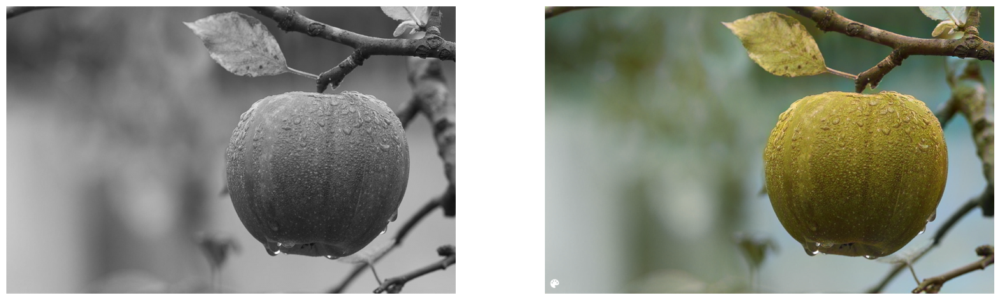

In [35]:
#testing object photos
source_url = 'https://media.geeksforgeeks.org/wp-content/uploads/gray.jpeg'
render_factor = 20
image_path = colorizer.plot_transformed_image_from_url(url=source_url, render_factor=render_factor, compare=True)
show_image_in_notebook(image_path)

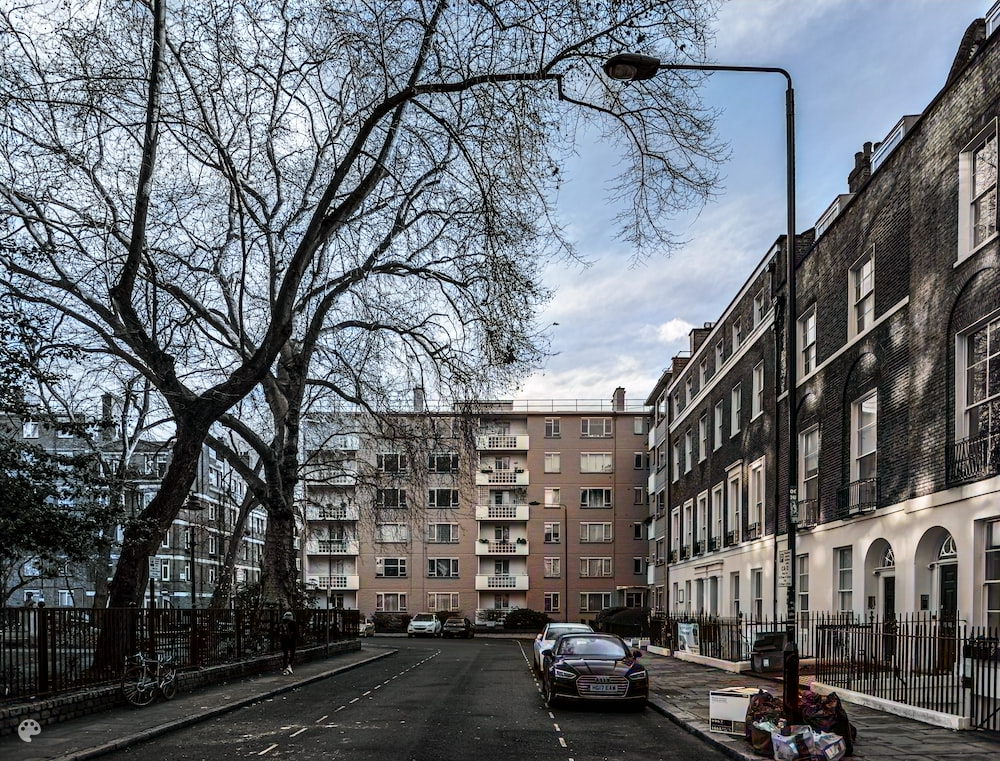

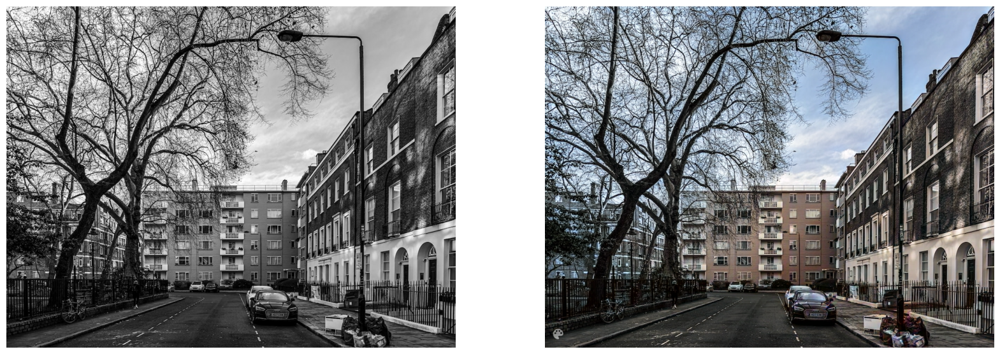

In [36]:
#testing landscape photos
source_url = 'https://images.unsplash.com/photo-1590992133988-6ffb251c607e?ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8Mnx8Z3JheXNjYWxlfGVufDB8fDB8fHww&w=1000&q=80'
render_factor = 20
image_path = colorizer.plot_transformed_image_from_url(url=source_url, render_factor=render_factor, compare=True)
show_image_in_notebook(image_path)